In [1]:
from google.colab import drive
drive.mount('/content/drive/')

Go to this URL in a browser: https://accounts.google.com/o/oauth2/auth?client_id=947318989803-6bn6qk8qdgf4n4g3pfee6491hc0brc4i.apps.googleusercontent.com&redirect_uri=urn%3aietf%3awg%3aoauth%3a2.0%3aoob&response_type=code&scope=email%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdocs.test%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive.photos.readonly%20https%3a%2f%2fwww.googleapis.com%2fauth%2fpeopleapi.readonly

Enter your authorization code:
··········
Mounted at /content/drive/


In [2]:
import tensorflow as tf
print(tf.__version__)

1.15.0


In [0]:
import time
from glob import glob

import matplotlib.pyplot as plt
import numpy as np
from imageio import imread
from PIL import Image
import os
import random
import collections

#Go to the right directory
os.chdir('/content/drive/My Drive/yetty/AI')
print('Current directory %s ' % os.getcwd())

Current directory /content/drive/My Drive/yetty/AI 


In [0]:
def conv2d(x, filter, kernel, stride, padding):
    return tf.layers.conv2d(inputs=x, filters=filter, kernel_size=kernel, strides=stride, padding=padding)

def conv2dTranspose(x, filter, kernel, stride, padding):
    return tf.layers.conv2d_transpose(inputs=x, filters=filter, kernel_size=kernel, strides=stride, padding=padding, use_bias=False)

def batchNormalization(x):
    return tf.layers.batch_normalization(inputs=x, axis=3, momentum=0.9, epsilon=1e-5)

def instanceNormalization(x):
    return tf.contrib.layers.instance_norm(inputs=x, center=True, scale=True)

def relu(x):
    return tf.nn.relu(features=x)

def leakyRelu(x,alpha=None):
    return tf.nn.leaky_relu(features=x,alpha=alpha)

def tanh(x):
    return tf.math.tanh(x=x)

def sigmoid(x):
    return tf.math.sigmoid(x=x)

def add(x,y):
    return tf.add(x,y)

In [0]:
def residual_block(x):
    """
    Residual block
    """
    res = tf.pad(x, [ [0, 0], [1, 1], [1, 1], [0, 0] ], "REFLECT")
    res = relu( batchNormalization( conv2d(res, 256, 3, 1, "valid") ) )
    res = tf.pad(res, [ [0, 0], [1, 1], [1, 1], [0, 0] ], "REFLECT" )
    res = batchNormalization( conv2d(res, 256, 3, 1, "valid") )
    return add(res, x)

In [0]:
def build_generator(image, A_or_B):
    """
    Create a generator network using the hyperparameter values defined below
    """
    residual_blocks = 9
    with tf.variable_scope(A_or_B+'_generator', reuse=tf.AUTO_REUSE):
        input = tf.pad(image, [[0, 0], [3, 3], [3, 3], [0, 0]], "REFLECT")
    
        # First Convolution block
        h_conv1 = relu( instanceNormalization( conv2d(input, 64, 7, 1, 'valid') ) )
        
        # 2nd Convolution block
        h_conv2 = relu( instanceNormalization( conv2d(h_conv1, 128, 3, 2, 'same') ) )

        # 3rd Convolution block
        h_conv3 = relu( instanceNormalization( conv2d(h_conv2, 256, 3, 2,'same') ) )
        
        # 9 Residual blocks
        for i in range(1, residual_blocks+1):
            residual = residual_block(h_conv3)
    
        # Upsampling blocks
        # 1st Upsampling block
        h_conv4 = relu( instanceNormalization( conv2dTranspose(residual, 128, 3, 2, 'same') ) )
    
        # 2nd Upsampling block
        h_conv5 = relu( instanceNormalization( conv2dTranspose(h_conv4, 64, 3, 2, 'same') ) )

        # Last Convolution layer
        output = tanh( conv2d(h_conv5, 3, 7, 1, 'same') )
    
        return output  

In [0]:
def build_discriminator(image, A_or_B):
    """
    Create a discriminator network using the hyperparameter values defined below
    """
    #Add some gaussian noise to the discriminator
    image = image + tf.random_normal(shape=tf.shape(image), mean=0.0, stddev=0.1, dtype=tf.float32)

    with tf.variable_scope(A_or_B + '_discriminator', reuse=tf.AUTO_REUSE ):
        # 1st Convolutional block
        h_conv1 = leakyRelu(conv2d(image, 64, 4, 2, "same"), alpha=0.2)

        # 3 Hidden Convolution blocks
        hidden_conv1 = leakyRelu(instanceNormalization(conv2d(h_conv1, 128, 4, 2, "same")))
        hidden_conv2 = leakyRelu(instanceNormalization(conv2d(hidden_conv1, 256, 4, 2, "same")))
        hidden_conv3 = leakyRelu(instanceNormalization(conv2d(hidden_conv2, 512, 4, 2, "same")))
    
        # Last Convolution layer
        output = conv2d(hidden_conv3, 1, 4, 1, "same")
        
        return output

In [0]:
def load_images(data_dirA, data_dirB):
    count = 0
    percentage = 10
    
    if not data_dirA == data_dirB:
        imagesA = glob(data_dirA+ '/*.*')
        imagesB = glob(data_dirB+ '/*.*')
        value = 33
    else:
        imagesA = glob(data_dirA+ '/trainA/*.*')
        imagesB = glob(data_dirA+ '/trainB/*.*')
        value = 107

    allImagesA = []
    allImagesB = []

    for index, filename in enumerate(imagesB):
        if count % value == 0:
            print("Stored %d%% images" %percentage)
            percentage += 10
        imgA = imread(imagesA[index], pilmode='RGB')
        imgB = imread(filename, pilmode='RGB')
        
        imgA = np.array(Image.fromarray(imgA).resize((256, 256)) )
        imgB = np.array(Image.fromarray(imgB).resize((256, 256)) )

        if np.random.random() > 0.5:
            imgA = np.fliplr(imgA)
            imgB = np.fliplr(imgB)

        allImagesA.append(imgA)
        allImagesB.append(imgB)
        count += 1

    # Normalize images
    allImagesA = np.array(allImagesA) / 127.5 - 1.
    allImagesB = np.array(allImagesB) / 127.5 - 1.

    return allImagesA, allImagesB

In [0]:
def load_test_batch(data_dir, batch_size):
    imagesA = glob(data_dir + '/testA/*.*')
    imagesB = glob(data_dir + '/testB/*.*')

    imagesA = np.random.choice(imagesA, batch_size)
    imagesB = np.random.choice(imagesB, batch_size)

    allA = []
    allB = []

    for index, filename in enumerate(imagesA):
        # Load images and resize images
        imgA = np.array(Image.fromarray(imread(filename, pilmode='RGB')).resize((256, 256)))
        imgB = np.array(Image.fromarray(imread(imagesB[index], pilmode='RGB')).resize((256, 256)))

        allA.append(imgA)
        allB.append(imgB)

    return np.array(allA) / 127.5 - 1.0, np.array(allB) / 127.5 - 1.0

In [0]:
def save_images(originalA, generatedB, reconstructedA, originalB, generatedA, reconstructedB, path, predicting):
    """
    Save images
    """
    if predicting:
        #Disable interactive plotting when predicting
        plt.ioff()
    
    fig = plt.figure(figsize=(15,15))
    ax = fig.add_subplot(2, 3, 1)
    ax.imshow(originalA)
    ax.axis("off")
    ax.set_title("OriginalA")
    if predicting:
        #Close fig
        plt.close(fig)

    ax = fig.add_subplot(2, 3, 2)
    ax.imshow(generatedB)
    ax.axis("off")
    ax.set_title("GeneratedB")

    ax = fig.add_subplot(2, 3, 3)
    ax.imshow(reconstructedA)
    ax.axis("off")
    ax.set_title("ReconstructedA")

    ax = fig.add_subplot(2, 3, 4)
    ax.imshow(originalB)
    ax.axis("off")
    ax.set_title("OriginalB")

    ax = fig.add_subplot(2, 3, 5)
    ax.imshow(generatedA)
    ax.axis("off")
    ax.set_title("GeneratedA")

    ax = fig.add_subplot(2, 3, 6)
    ax.imshow(reconstructedB)
    ax.axis("off")
    ax.set_title("ReconstructedB")

    plt.savefig(path)


In [0]:
def add_summary(writer, name, value, global_step):
    summary = tf.Summary(value=[tf.Summary.Value(tag=name, simple_value=value)])
    writer.add_summary(summary, global_step=global_step)

In [0]:
def CycleGAN():
    
    real_imageA = tf.placeholder("float", shape=[None, 256, 256, 3], name="Real_Image_A")    
    real_imageB = tf.placeholder("float", shape=[None, 256, 256, 3], name="Real_Image_B")
    
    
    fake_imageB = build_generator(real_imageA,A_or_B='AtoB')
    fake_imageA = build_generator(real_imageB, A_or_B='BtoA')
    
    reconstructedB = build_generator(fake_imageA,A_or_B='AtoB')
    reconstructedA = build_generator(fake_imageB, A_or_B='BtoA')
    
    
    probIsRealA = build_discriminator(real_imageA, A_or_B='A')
    probIsFakeA = build_discriminator(fake_imageA, A_or_B='A')

    probIsRealB = build_discriminator(real_imageB, A_or_B='B')
    probIsFakeB = build_discriminator(fake_imageB, A_or_B='B')
    
    with tf.variable_scope('cyclic_loss'):
        g_loss_a_to_b = tf.losses.mean_squared_error(labels=probIsFakeB, predictions=tf.ones_like(probIsFakeA))
        g_loss_b_to_a = tf.losses.mean_squared_error(labels=probIsFakeA, predictions=tf.ones_like(probIsFakeA))
        cyc_loss_a = tf.losses.absolute_difference(real_imageA, reconstructedA) # forward cycle loss
        cyc_loss_b = tf.losses.absolute_difference(real_imageB, reconstructedB) # backward cycle loss     
        g_total_loss = g_loss_a_to_b + g_loss_b_to_a + cyc_loss_a * 10.0 + cyc_loss_b * 10.0

        # only one cycle loss - only cycle loss a (forward cycle loss)
        # g_total_loss =  g_loss_a_to_b + g_loss_b_to_a + cyc_loss_a * 10.0

        # only GAN adversarial loss
        # g_total_loss =  g_loss_a_to_b + g_loss_b_to_a 

        # only cycle loss
        # g_total_loss =  cyc_loss_a * 10.0 + cyc_loss_b * 10.0

    with tf.variable_scope("discriminator_A_loss"):
        da_loss_real = tf.losses.mean_squared_error(labels=probIsRealA, predictions=tf.ones_like(probIsRealA))
        da_loss_b_to_a_fake = tf.losses.mean_squared_error(labels=probIsFakeA, predictions=tf.zeros_like(probIsFakeA))
        da_total_loss = da_loss_real + da_loss_b_to_a_fake

    with tf.variable_scope("discriminator_B_loss"):
        db_loss_real = tf.losses.mean_squared_error(labels=probIsRealB, predictions=tf.ones_like(probIsRealB))
        db_loss_a_to_b_sample = tf.losses.mean_squared_error(labels=probIsFakeB, predictions=tf.zeros_like(probIsFakeB))
        db_total_loss = db_loss_real + db_loss_a_to_b_sample
    
    with tf.variable_scope("train"):     
        tvars = tf.trainable_variables()
        dA_vars = [var for var in tvars if 'A_discriminator' in var.name]
        dB_vars = [var for var in tvars if 'B_discriminator' in var.name]
        g_vars = [var for var in tvars if 'AtoB_generator' in var.name or 'BtoA_generator' in var.name]

        starter_learning_rate = 0.0002
        adam = tf.train.AdamOptimizer(learning_rate=starter_learning_rate, beta1=0.5)

        trainerDA = adam.minimize(da_total_loss, var_list=dA_vars)
        trainerDB = adam.minimize(db_total_loss, var_list=dB_vars)
        trainerG = adam.minimize(g_total_loss, var_list=g_vars)
    
    return real_imageA, real_imageB, fake_imageA, fake_imageB, reconstructedA, reconstructedB, da_total_loss, db_total_loss, g_total_loss, trainerDA, trainerDB, trainerG

In [0]:
# !mkdir logs
# !mkdir checkpoints
# !mkdir models
# !mkdir results

log_dir = "/content/drive/My Drive/yetty/AI/logs"
checkpoint_save_path =  "/content/drive/My Drive/yetty/AI/checkpoints/model.ckpt"
meta_graph_path = "/content/drive/My Drive/yetty/AI/models/model.ckpt.meta"
complete_model_path = "/content/drive/My Drive/yetty/AI/models/model.ckpt"
train_results_path = "/content/drive/My Drive/yetty/AI/results"

!ls "/content/drive/My Drive/yetty/AI"

checkpoints  data  logs  models  results


In [0]:
dataset_path = "/content/drive/My Drive/yetty/AI/data"
imagesA, imagesB = load_images(dataset_path, dataset_path)
len(imagesA)

Stored 10% images
Stored 20% images
Stored 30% images
Stored 40% images
Stored 50% images
Stored 60% images
Stored 70% images
Stored 80% images
Stored 90% images
Stored 100% images


995

In [0]:
print(len(imagesA))
print(len(imagesB))

995
995


Instructions for updating:
Use `tf.keras.layers.Conv2D` instead.
Instructions for updating:
Please use `layer.__call__` method instead.
The TensorFlow contrib module will not be included in TensorFlow 2.0.
For more information, please see:
  * https://github.com/tensorflow/community/blob/master/rfcs/20180907-contrib-sunset.md
  * https://github.com/tensorflow/addons
  * https://github.com/tensorflow/io (for I/O related ops)
If you depend on functionality not listed there, please file an issue.

Instructions for updating:
Use keras.layers.BatchNormalization instead.  In particular, `tf.control_dependencies(tf.GraphKeys.UPDATE_OPS)` should not be used (consult the `tf.keras.layers.batch_normalization` documentation).
Instructions for updating:
Use `tf.keras.layers.Conv2DTranspose` instead.
Instructions for updating:
Use tf.where in 2.0, which has the same broadcast rule as np.where
Starting Creating Model.....

Starting training...

Epoch 1
Elapsed 184.898 seconds. 

Number of images pro

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i


Epoch 2
Elapsed 134.886 seconds. 

Number of images processed is 995
Cyclic Loss: 4.7674	Discriminator A Loss: 0.0000	Discriminator B Loss: 0.0000 *** 


Epoch 3
Elapsed 176.518 seconds. 

Number of images processed is 995
Cyclic Loss: 5.1986	Discriminator A Loss: 0.4630	Discriminator B Loss: 0.4596 *** 



Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i


Epoch 4
Elapsed 134.626 seconds. 

Number of images processed is 995
Cyclic Loss: 4.0651	Discriminator A Loss: 0.0000	Discriminator B Loss: 0.0000 *** 


Epoch 5
Elapsed 176.526 seconds. 

Number of images processed is 995
Cyclic Loss: 4.5411	Discriminator A Loss: 0.4890	Discriminator B Loss: 0.4658 *** 



Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i


Epoch 6
Elapsed 134.632 seconds. 

Number of images processed is 995
Cyclic Loss: 3.7529	Discriminator A Loss: 0.0000	Discriminator B Loss: 0.0000 *** 


Epoch 7
Elapsed 176.521 seconds. 

Number of images processed is 995
Cyclic Loss: 4.2507	Discriminator A Loss: 0.4876	Discriminator B Loss: 0.4583 *** 



Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i


Epoch 8
Elapsed 134.865 seconds. 

Number of images processed is 995
Cyclic Loss: 3.5339	Discriminator A Loss: 0.0000	Discriminator B Loss: 0.0000 *** 


Epoch 9
Elapsed 176.288 seconds. 

Number of images processed is 995
Cyclic Loss: 4.1143	Discriminator A Loss: 0.4668	Discriminator B Loss: 0.4365 *** 



/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:9: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  if __name__ == '__main__':
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0


Epoch 10
Elapsed 134.550 seconds. 

Number of images processed is 995
Cyclic Loss: 3.3875	Discriminator A Loss: 0.0000	Discriminator B Loss: 0.0000 *** 

Instructions for updating:
Use standard file APIs to delete files with this prefix.


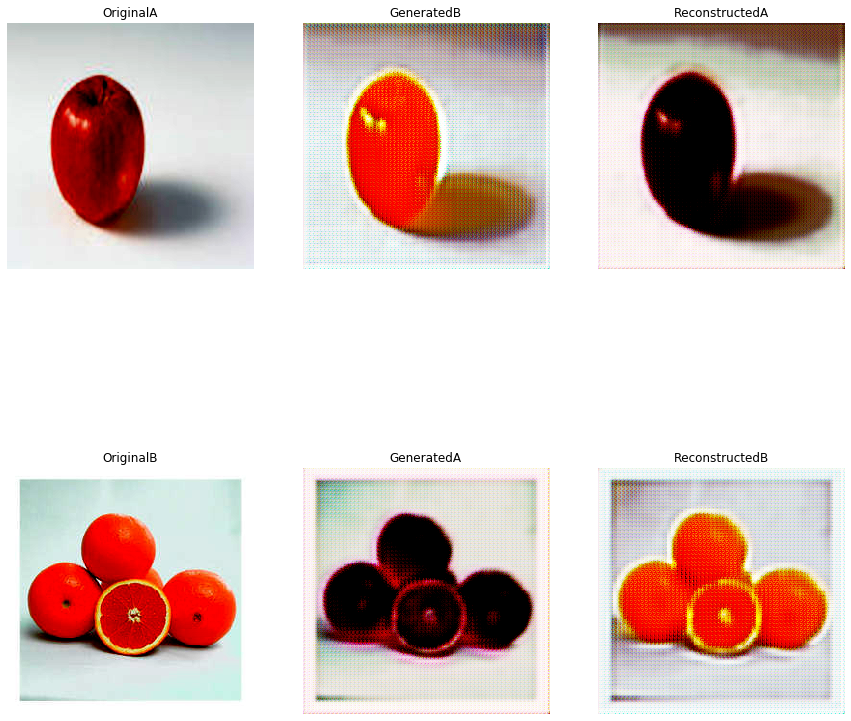

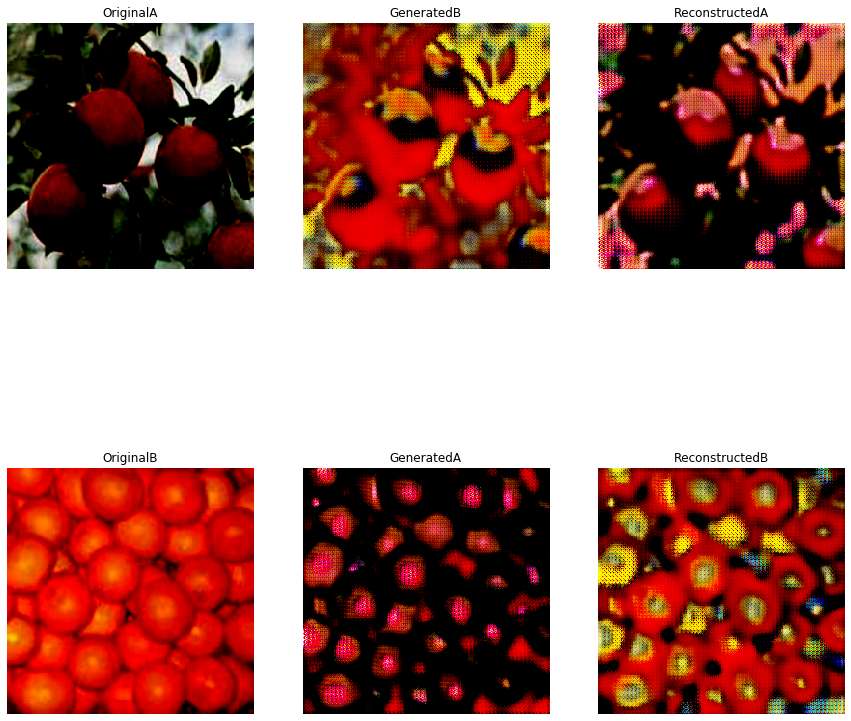

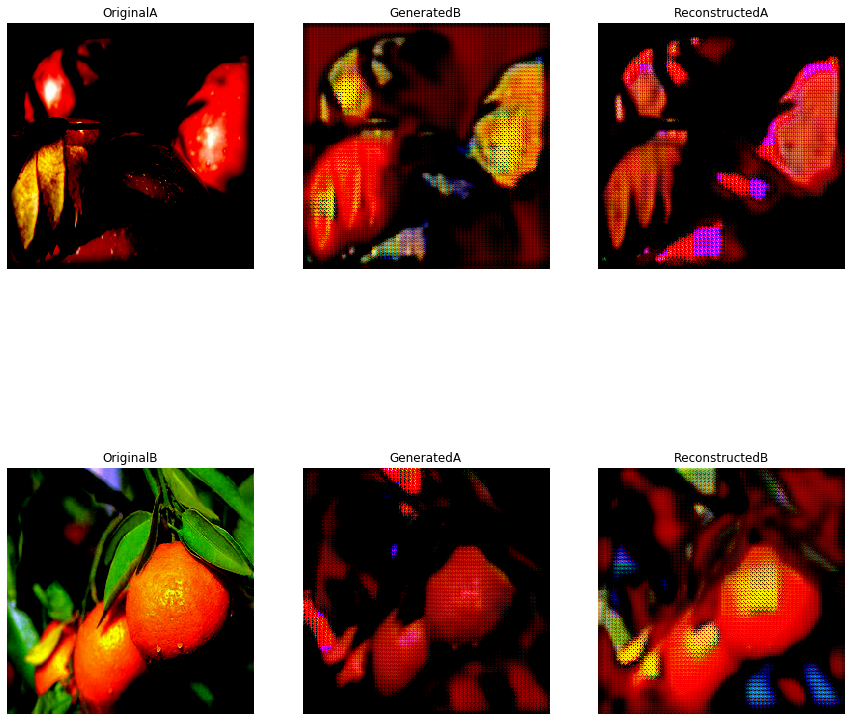

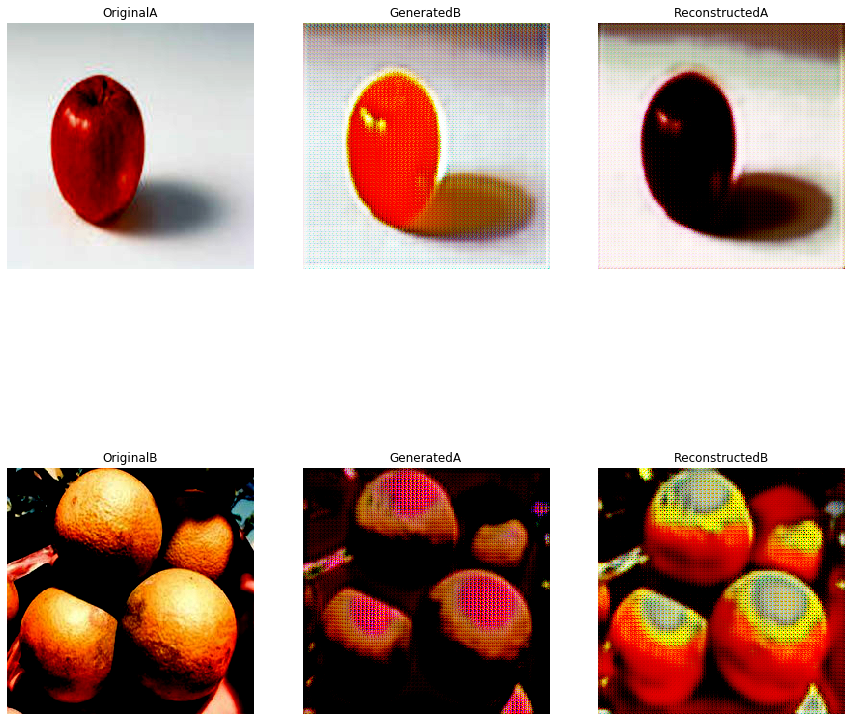

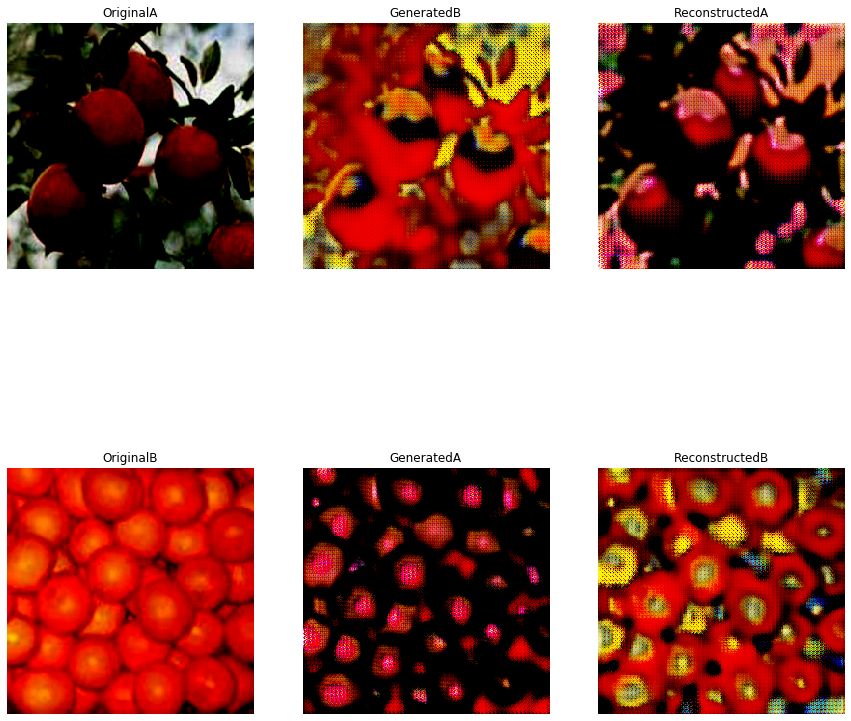

...

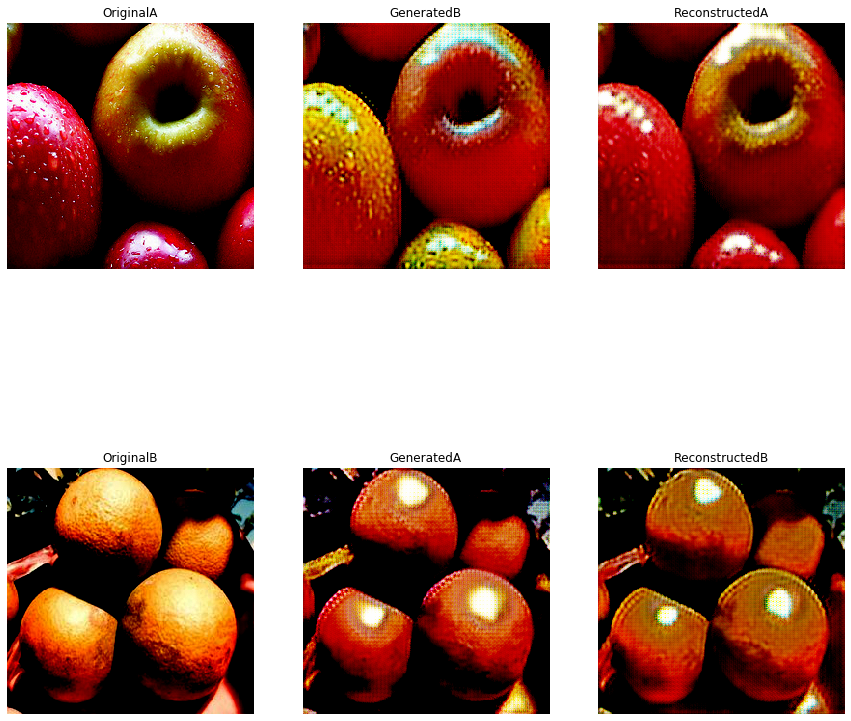

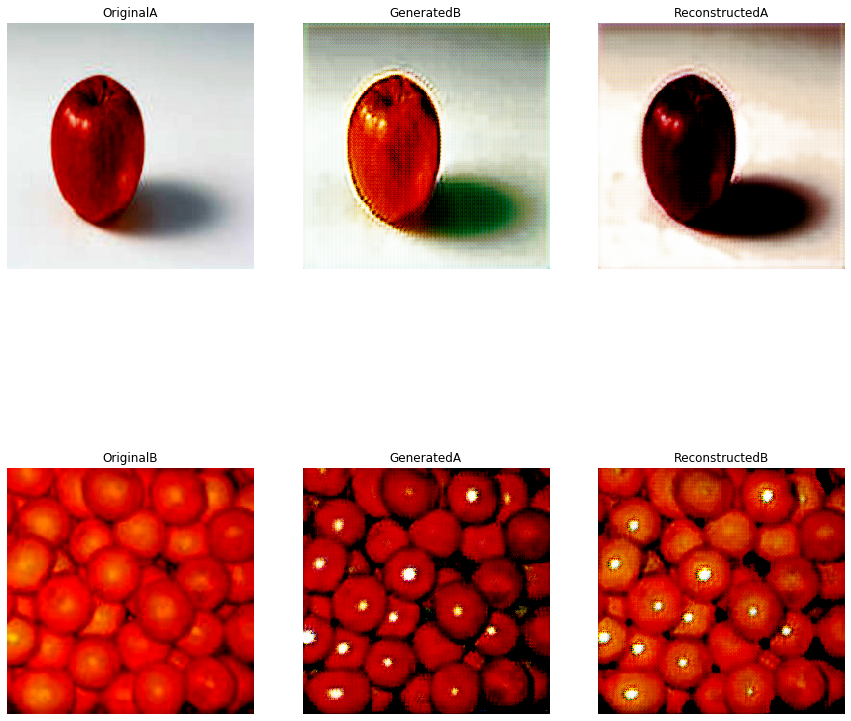

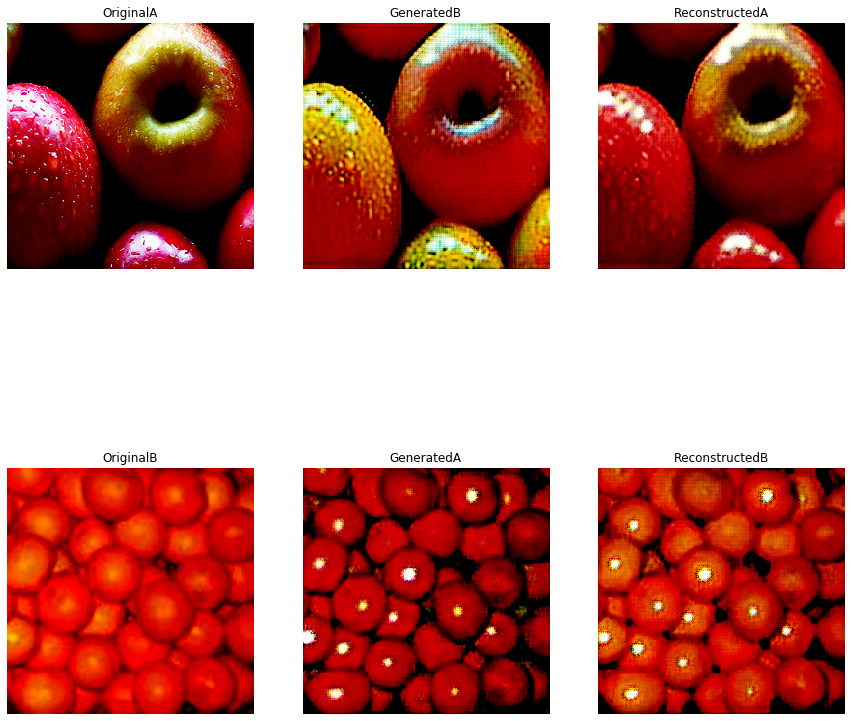

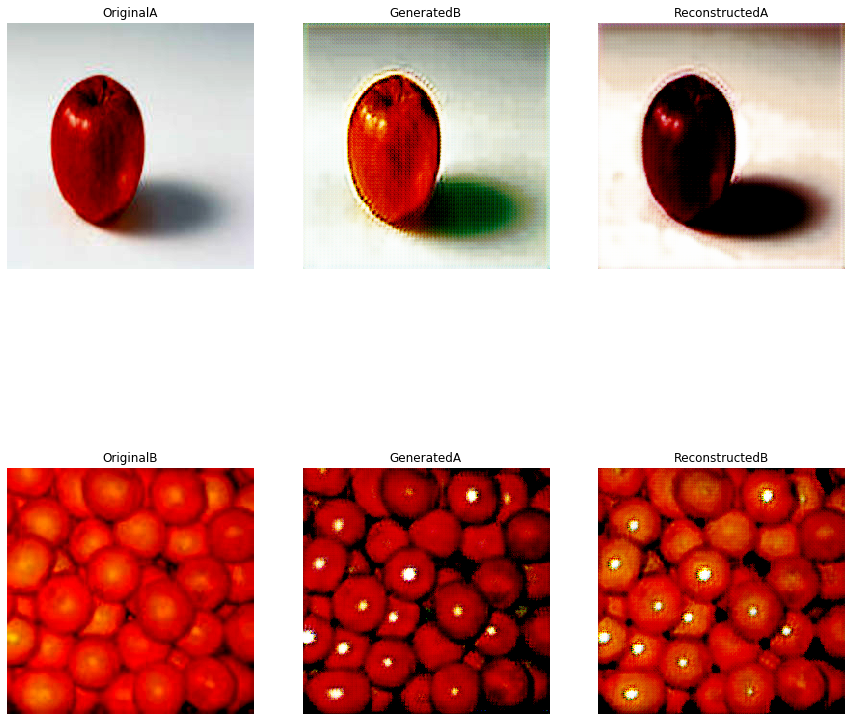

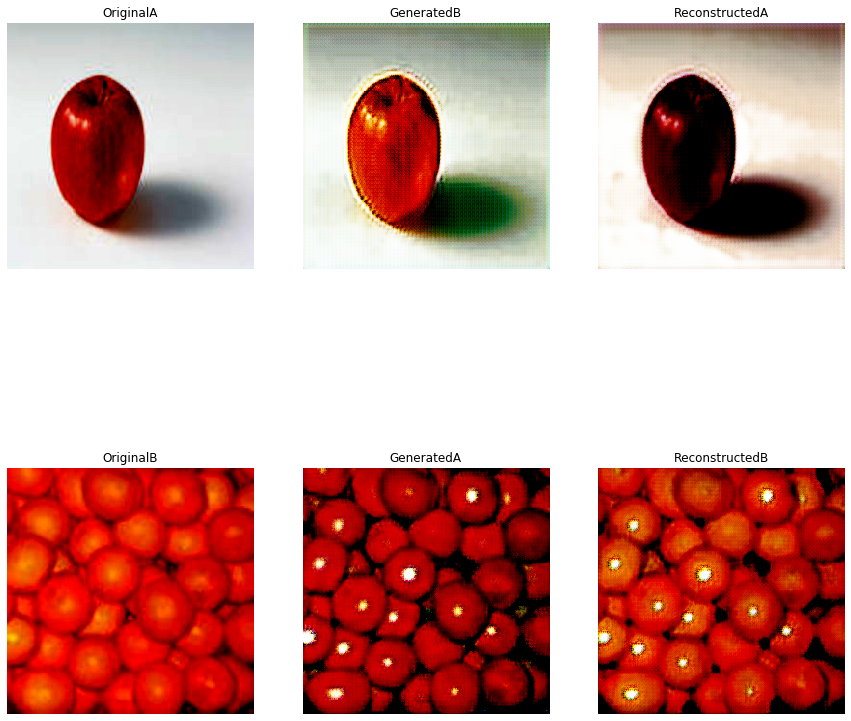

In [0]:
epochs = 10
no_of_images_processed = 0

tf.reset_default_graph()
g = tf.Graph()
with g.as_default():  
    real_imageA, real_imageB, fake_imageA, fake_imageB, reconstructedA, reconstructedB, da_total_loss, db_total_loss, g_total_loss, trainerDA, trainerDB, trainerG = CycleGAN()
    saver = tf.train.Saver() 
    
with tf.Session(graph=g) as sess:
    
    print("Starting Creating Model.....")
    sess.run(tf.local_variables_initializer())
    sess.run(tf.global_variables_initializer()) 
    print("\nStarting training...")    
    train_writer = tf.summary.FileWriter(log_dir, sess.graph)
    try:
        for epoch in range(0, epochs):
            print("\nEpoch", epoch + 1)
            epoch_da_loss, epoch_db_loss, epoch_g_loss = 0., 0., 0.
            no_of_images_processed = 0
            start = time.perf_counter()
            print("======="*10)

            for imageA, imageB in zip(imagesA, imagesB):
                imageA = np.reshape(imageA, [1, 256,256,3])
                imageB = np.reshape(imageB, [1, 256, 256, 3])
                no_of_images_processed += 1
                #Retrieve the output of the two generators (A and B)
                A_Fake, B_Fake = sess.run([fake_imageA, fake_imageB], feed_dict={real_imageA:imageA, real_imageB:imageB})
                #Retrieve cyclic loss
                g_loss_val, _ = sess.run([g_total_loss, trainerG], feed_dict={real_imageA:imageA, real_imageB:imageB})
                epoch_g_loss += g_loss_val

                #Retrieve loss of discriminator A
                if epoch%2==0:
                  d_A_loss_val, _ = sess.run([da_total_loss, trainerDA], feed_dict={real_imageA:imageA, real_imageB:imageB})
                  epoch_da_loss += d_A_loss_val
                  #Retrieve loss of discriminator B
                  d_B_loss_val, _ = sess.run([db_total_loss, trainerDB], feed_dict={real_imageA:imageA, real_imageB:imageB})
                  epoch_db_loss += d_B_loss_val 

                    
            elapsed = time.perf_counter() - start
            print('Elapsed %.3f seconds. \n' % elapsed)
            print('Number of images processed is {}'.format(no_of_images_processed))
            epoch_g_loss /= no_of_images_processed
            epoch_da_loss /= no_of_images_processed
            epoch_db_loss /= no_of_images_processed
            print("Cyclic Loss: {:.4f}\tDiscriminator A Loss: {:.4f}\tDiscriminator B Loss: {:.4f} ".format(epoch_g_loss, epoch_da_loss, epoch_db_loss), end="*** \r")

            add_summary(train_writer, "epoch_g_loss", epoch_g_loss, epoch)
            add_summary(train_writer, "epoch_da_loss", epoch_da_loss, epoch)
            add_summary(train_writer, "epoch_db_loss", epoch_db_loss, epoch)
            print("\n")
            print("======="*10)
            if epoch%2 == 0:
                # Save a checkpoint
                save_path = saver.save(sess, checkpoint_save_path+'{}'.format(epoch)+'.ckpt')
                
                batchA, batchB = load_test_batch(data_dir=dataset_path, batch_size=5)
                inputA = g.get_tensor_by_name("Real_Image_A:0")
                inputB = g.get_tensor_by_name("Real_Image_B:0")

                # Get the generator tensors and their output 
                fake_imageB = g.get_tensor_by_name('AtoB_generator/Tanh:0')
                fake_imageA = g.get_tensor_by_name('BtoA_generator/Tanh:0')
                fakeB, fakeA = sess.run([fake_imageB, fake_imageA], feed_dict= {real_imageA:batchA, real_imageB:batchB})

                # Get reconstructed images
                reconstructedA = g.get_tensor_by_name("BtoA_generator_1/Tanh:0")
                reconstructedB = g.get_tensor_by_name("AtoB_generator_1/Tanh:0")
                reconstructed_imageA, reconstructed_imageB = sess.run([reconstructedA, reconstructedB], feed_dict={real_imageA:batchA, real_imageB:batchB})

                # Show the generated and reconstructed images
                for i in range(0,5):
                  save_images(originalA=batchA[i], generatedB=fakeB[i], reconstructedA=reconstructed_imageA[i], originalB=batchB[i], generatedA=fakeA[i], reconstructedB=reconstructed_imageB[i], path=train_results_path+"/learn{}_{}".format(epoch, i), predicting=False)
    except KeyboardInterrupt:
        print("Keyboard interruption. Saving")
        save_path = saver.save(sess, complete_model_path)
        train_writer.close()
    save_path = saver.save(sess, complete_model_path)
    train_writer.close()        


# **EVALUATION**

In [0]:
%load_ext tensorboard
%tensorboard --logdir logs/